# Project ARI3129 - Object Detection & Localisation using Yolov8 *(Jupyter Notebook #1)*
---

**Name:** Thomas Koppens
**ID No:** 0029204L

---

In [1]:
from torchvision.datasets import CocoDetection
from torch.utils.data import DataLoader
from torchvision.transforms import functional as F
import torch
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as patches
from torchvision.models.detection import retinanet_resnet50_fpn_v2
from torchvision.models.detection.retinanet import RetinaNetClassificationHead
from functools import partial
import time
from tqdm import tqdm

## Dataset Preparation

The MDD dataset was exported from Roboflow using the COCO format.  This cell compiles the dataset into 3 PyTorch dataloaders for straightforward use later on.

Note that the bounding box format is changed during annotation generation from x, y, width, height -> x1, y1, x2, y2.

Furthermore, issues were encountered which were later determined to be caused by an extra category "waste" being generated by Roboflow.  The annotation generation phase ensures that no annotations with this label are added to the dataset (although there are no such cases).

In [2]:
batch_size = 16

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("USING DEVICE", device)

class MDD(CocoDetection):
    def __init__(self, root, annFile):
        super().__init__(root, annFile)
        
    def __getitem__(self, index):
        try:
            img, target = super().__getitem__(index)
            img = F.to_tensor(img)
            
            boxes = []
            labels = []
            for annotation in target:
                bbox = annotation["bbox"]
                # swapping to the more intuitive corners method
                boxes.append([bbox[0], bbox[1], bbox[0] + bbox[2], bbox[1] + bbox[3]])

                # removing the errenous category
                if annotation["category_id"] != 0:
                    labels.append(annotation["category_id"])
            
            boxes = torch.FloatTensor(boxes)
            labels = torch.LongTensor(labels)
            
            target_dict = {
                "boxes": boxes,
                "labels": labels,
                "image_id": torch.tensor([index])
            }
            return img, target_dict
            
        except Exception as e:
            print(f"Error loading index {index}: {str(e)}")
            raise e


dataset_root = "../Versions/MDD-TK-COCO/"
ann_file_name = "_annotations.coco.json"
train_images = dataset_root + "train/"
train_annotations = train_images + ann_file_name
val_images = dataset_root + "valid/"
val_annotations = val_images + ann_file_name
test_images = dataset_root + "test/"
test_annotations = test_images + ann_file_name

def collate_fn(batch):
    images, targets = zip(*batch)
    images = torch.stack(images, dim=0)
    return images, targets


# Create datasets
train_dataset = MDD(root=train_images, annFile=train_annotations)
val_dataset = MDD(root=val_images, annFile=val_annotations)
test_dataset = MDD(root=test_images, annFile=test_annotations)

print("Dataset sizes:")
print(f"Train: {len(train_dataset)}")
print(f"Val: {len(val_dataset)}")
print(f"Test: {len(test_dataset)}")

train_dataloader = DataLoader(
    train_dataset, 
    batch_size=batch_size,
    shuffle=True,
    collate_fn=collate_fn,
)

val_dataloader = DataLoader(
    val_dataset, 
    batch_size=batch_size,
    shuffle=False,
    collate_fn=collate_fn,
)

test_dataloader = DataLoader(
    test_dataset, 
    batch_size=batch_size,
    shuffle=False,
    collate_fn=collate_fn,
)

print("\nDataset Preparation Complete!")

USING DEVICE cuda
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Dataset sizes:
Train: 748
Val: 70
Test: 34

Dataset Preparation Complete!


## Understanding the data
This cell was used to understand the data during debugging.

In [3]:
print("TRAIN LOADER")
for images, targets in train_dataloader:
    print(f"Images batch shape: {images.shape}")
    print(f"Targets batch length: {len(targets)}")
    print(f"First target: {targets[0]}")
    break

print("\nVAL LOADER")
for images, targets in val_dataloader:
    print(f"Images batch shape: {[image.shape for image in images]}")
    print(f"Targets batch length: {len(targets)}")
    print(f"First target: {targets[0]}")
    break


TRAIN LOADER
Images batch shape: torch.Size([16, 3, 640, 640])
Targets batch length: 16
First target: {'boxes': tensor([[446.0000, 371.0000, 495.6770, 404.1170],
        [187.0000,  84.0000, 422.3720, 306.2140]]), 'labels': tensor([2, 3]), 'image_id': tensor([205])}

VAL LOADER
Images batch shape: [torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640]), torch.Size([3, 640, 640])]
Targets batch length: 16
First target: {'boxes': tensor([[198., 373., 397., 562.]]), 'labels': tensor([1]), 'image_id': tensor([0])}


## Create Model
RetinaNet is loaded with the latest weights.  Then, the head is replaced with one containing 4 classes.

In [4]:
model = retinanet_resnet50_fpn_v2(weights="DEFAULT")  # using most recent weights

# replacing head for our 4-class problem
num_classes = len(train_dataset.coco.getCatIds())
num_anchors = model.head.classification_head.num_anchors
model.head.classification_head = RetinaNetClassificationHead(in_channels=256, num_anchors=num_anchors, num_classes=num_classes, norm_layer=partial(torch.nn.GroupNorm, 32))

## Hyperparameter Section

In [5]:
model_name = "retinanet_v6"
epochs = 10
optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001)
patience = 2


## Training
Unlike the Ultralytics approaches in the other two notebooks, this approach requires the manual creation of a training loop.  A straightfoward loop is used with the addition of early stopping logic used on the validation set's loss.  The best model is always saved such that it may be retrieved later on since, once the patience has run out, a worse the model will have overfit.

The loss histories are also saved for visualisation of the training process, in order to understand factors such as the stability of training and the gap between the train and validation losses over time.

In [6]:
early_stop = False
best_val_loss = float("inf")
epochs_no_improve = 0
history = {
    "train_loss": [],
    "val_loss": [],
}

# Training loop
model = model.to(device)
model.train()
for epoch in range(epochs):
    if early_stop:
        break
    print(f"\nEpoch {epoch + 1}/{epochs}")
    epoch_start = time.time()

    total_loss = 0

    # Training phase
    model.train()
    train_loss = 0.0
    for images, targets in tqdm(train_dataloader):
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # Forward pass
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        # Backward pass
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()
    
    print("TRAIN LOSS DICT")
    print(loss_dict)
    print("TRAIN LOSS:", total_loss / len(train_dataloader))
    history["train_loss"].append(total_loss / len(train_dataloader))

    total_loss = 0

    with torch.no_grad():
        for images, targets in val_dataloader:
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())


            total_loss += losses.item()
    print("VAL LOSS:", total_loss / len(val_dataloader))

    history["val_loss"].append(total_loss / len(val_dataloader))

    """ EARLY STOPPING """
    if history["val_loss"][-1] < best_val_loss:
        torch.save(model.state_dict(), f"runs/detect/{model_name}.pt")
        epochs_no_improve = 0
    else:
        epochs_no_improve += 1

    if epochs_no_improve >= patience:
        print(f"EARLY STOPPING... BEST MODEL WAS AT EPOCH {epoch - patience}")
        early_stop = True
        break

print("Training complete.")



Epoch 1/10


100%|██████████| 47/47 [05:41<00:00,  7.26s/it]


TRAIN LOSS DICT
{'classification': tensor(0.3514, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.1282, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.7133451427551026
VAL LOSS: 0.5379398465156555

Epoch 2/10


100%|██████████| 47/47 [05:38<00:00,  7.19s/it]


TRAIN LOSS DICT
{'classification': tensor(0.1976, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.1019, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.4667697618616388
VAL LOSS: 0.43956564664840697

Epoch 3/10


100%|██████████| 47/47 [05:44<00:00,  7.33s/it]


TRAIN LOSS DICT
{'classification': tensor(0.1345, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.0862, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.3123396425805193
VAL LOSS: 0.3976085245609283

Epoch 4/10


100%|██████████| 47/47 [05:45<00:00,  7.35s/it]


TRAIN LOSS DICT
{'classification': tensor(0.1446, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.1181, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.2518679616933173
VAL LOSS: 0.411114764213562

Epoch 5/10


100%|██████████| 47/47 [05:49<00:00,  7.45s/it]


TRAIN LOSS DICT
{'classification': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.0661, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.18130760687462827
VAL LOSS: 0.47098860144615173

Epoch 6/10


100%|██████████| 47/47 [05:35<00:00,  7.13s/it]


TRAIN LOSS DICT
{'classification': tensor(0.0840, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.1034, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.14528194006453168
VAL LOSS: 0.4262943804264069

Epoch 7/10


100%|██████████| 47/47 [05:43<00:00,  7.31s/it]


TRAIN LOSS DICT
{'classification': tensor(0.0389, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.0724, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.1209329328638442
VAL LOSS: 0.4700563907623291

Epoch 8/10


100%|██████████| 47/47 [05:41<00:00,  7.26s/it]


TRAIN LOSS DICT
{'classification': tensor(0.0343, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.0485, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.10309706374685815
VAL LOSS: 0.45072805881500244

Epoch 9/10


100%|██████████| 47/47 [05:51<00:00,  7.47s/it]


TRAIN LOSS DICT
{'classification': tensor(0.0247, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.0505, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.10565938388413572
VAL LOSS: 0.44894325733184814

Epoch 10/10


100%|██████████| 47/47 [05:55<00:00,  7.57s/it]


TRAIN LOSS DICT
{'classification': tensor(0.0292, device='cuda:0', grad_fn=<DivBackward0>), 'bbox_regression': tensor(0.0565, device='cuda:0', grad_fn=<DivBackward0>)}
TRAIN LOSS: 0.0907508061128728
VAL LOSS: 0.42325702905654905
Training complete.


## Loss History Visualisation

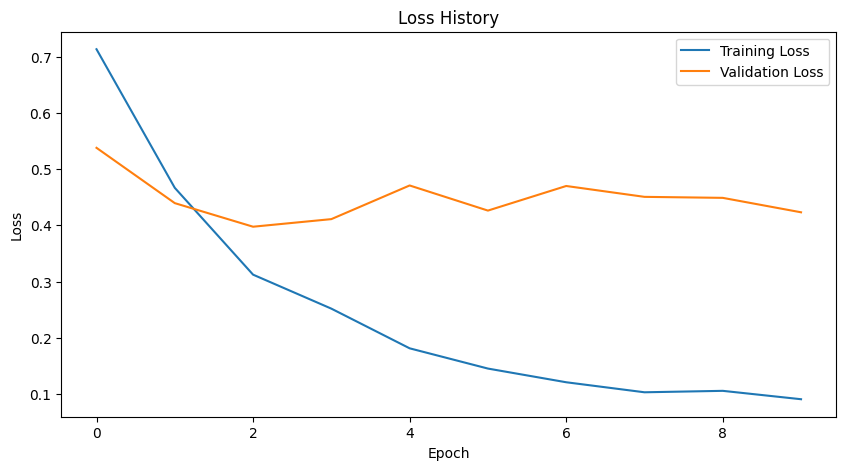

In [7]:

plt.figure(figsize=(10, 5))
plt.plot(history["train_loss"], label="Training Loss")
plt.plot(history["val_loss"], label="Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss History")
plt.legend()
plt.show()

## Loading the Checkpoint
As previously discussed, the model will overfit after the early stopping's patience has run out.  Thus, the model is reverted to its best weights.  Additionally, this cell was used often whenever returning to the project, since the model would no longer be in memory.

In [11]:
# del model

state = torch.load("runs/detect/retinanet_v5.pt")
model = retinanet_resnet50_fpn_v2()
num_anchors = model.head.classification_head.num_anchors
model.head.classification_head = RetinaNetClassificationHead(in_channels=256, num_anchors=num_anchors, num_classes=num_classes, norm_layer=partial(torch.nn.GroupNorm, 32))
model.load_state_dict(state)
model.to(device)
model.eval()

C:\Users\koppe\AppData\Local\Temp\ipykernel_15916\528232555.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load("runs/detect/retinanet_v5.pt")


RetinaNet(
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      

## Evaluation
Attempts were made to visualise the multi-label confusion matrix of the model's predictions on the test set -- as done by Ultralytics.  However, this proved to be more complex than creating and training the model itself.  Thus, only the mAP50 and mAP50-95 have been used to evaluate the model and compare results to those in the other notebooks.

In [12]:
from torchmetrics.detection.mean_ap import MeanAveragePrecision

def filter_predictions(predictions, confidence_threshold=0.5, max_predictions=100):
    filtered = []
    for pred in predictions:
        # NMS
        mask = pred["scores"] > confidence_threshold
        filtered_boxes = pred["boxes"][mask]
        filtered_scores = pred["scores"][mask]
        filtered_labels = pred["labels"][mask]

        filtered.append({
            "boxes": filtered_boxes[:max_predictions],
            "scores": filtered_scores[:max_predictions],
            "labels": filtered_labels[:max_predictions],
        })
    return filtered

metric = MeanAveragePrecision(box_format="xyxy")  # since we're using the corners method

for images, targets in test_dataloader:
    images = images.to(device)
    targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

    with torch.no_grad():
        outputs = model(images)
    filtered_predictions = filter_predictions(outputs)
    metric.update(filtered_predictions, targets)

    
result = metric.compute()
print(result)
print(f"mAP50: {result['map_50'].item():.3f}")
print(f"mAP50-95: {result['map'].item():.3f}")

    

{'map': tensor(0.4694), 'map_50': tensor(0.6589), 'map_75': tensor(0.5152), 'map_small': tensor(0.), 'map_medium': tensor(0.3467), 'map_large': tensor(0.6087), 'mar_1': tensor(0.2668), 'mar_10': tensor(0.5366), 'mar_100': tensor(0.5366), 'mar_small': tensor(0.), 'mar_medium': tensor(0.4199), 'mar_large': tensor(0.6564), 'map_per_class': tensor(-1.), 'mar_100_per_class': tensor(-1.), 'classes': tensor([1, 2, 3, 4], dtype=torch.int32)}
mAP50: 0.659
mAP50-95: 0.469


## Visualisation of Test Set Predictions
This cell compares the ground truth boxes/labels to those predicted during evaluation.











Ground Truth Labels

Organic Waste: 6
Predicted Labels

Organic Waste: 5
Recyclable Waste: 1


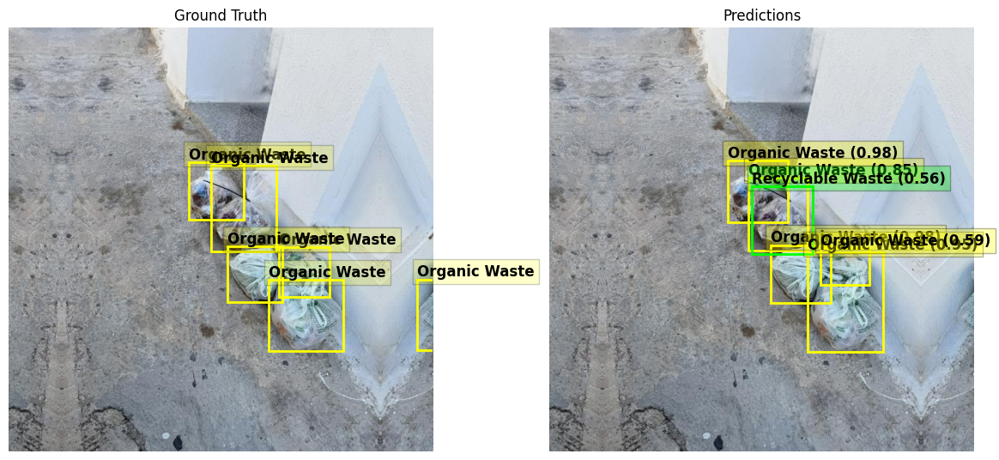











Ground Truth Labels

Organic Waste: 1
Predicted Labels

Organic Waste: 1


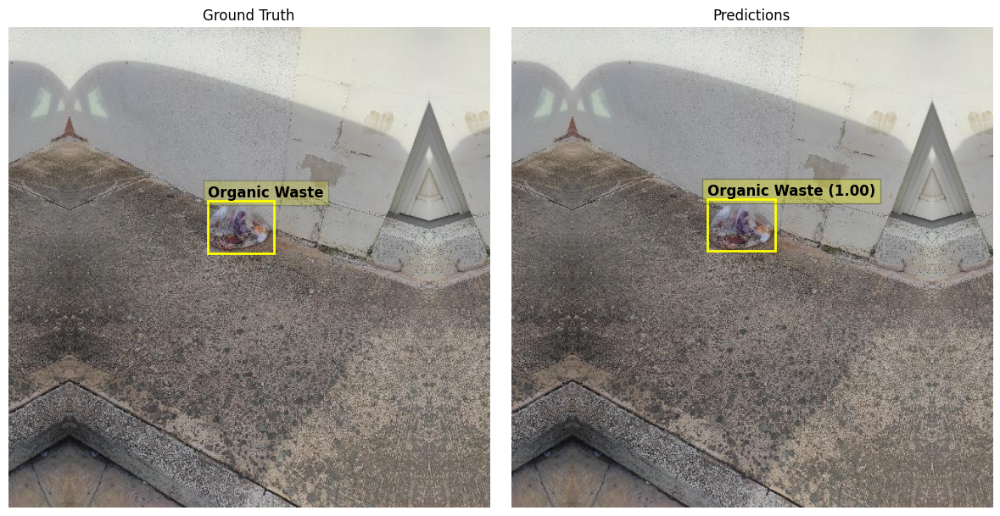











Ground Truth Labels

Recyclable Waste: 4
Other Waste: 3
Predicted Labels

Recyclable Waste: 3
Other Waste: 3


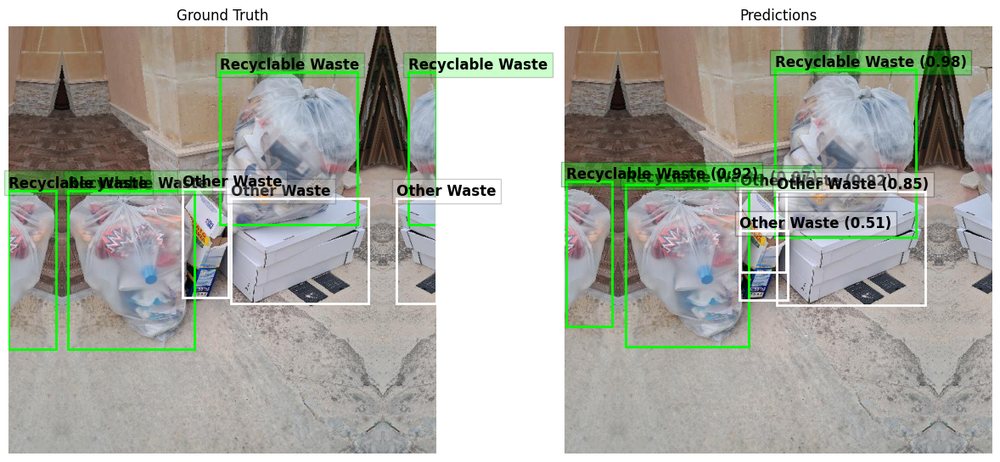











Ground Truth Labels

Organic Waste: 1
Other Waste: 1
Predicted Labels

Organic Waste: 1
Other Waste: 3
Recyclable Waste: 1


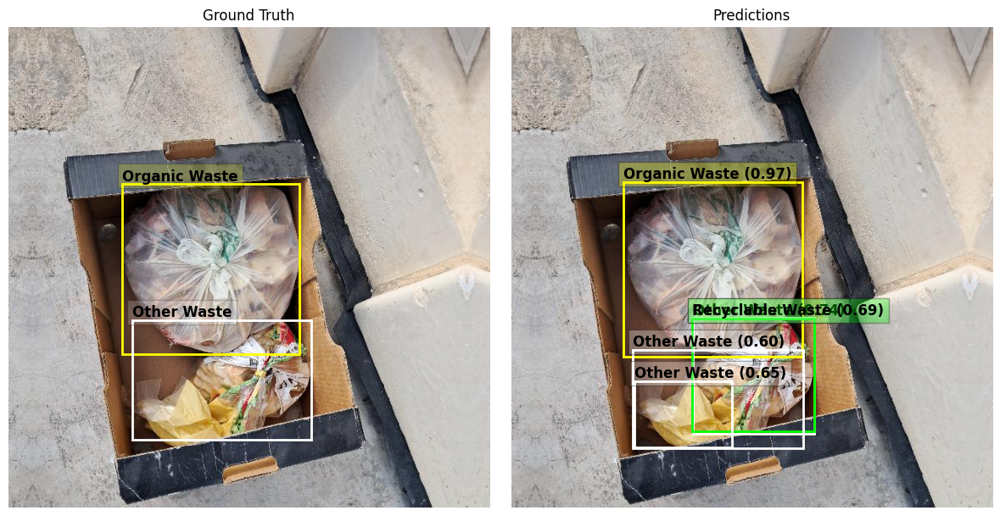











Ground Truth Labels

Recyclable Waste: 3
Predicted Labels

Recyclable Waste: 2
Other Waste: 1


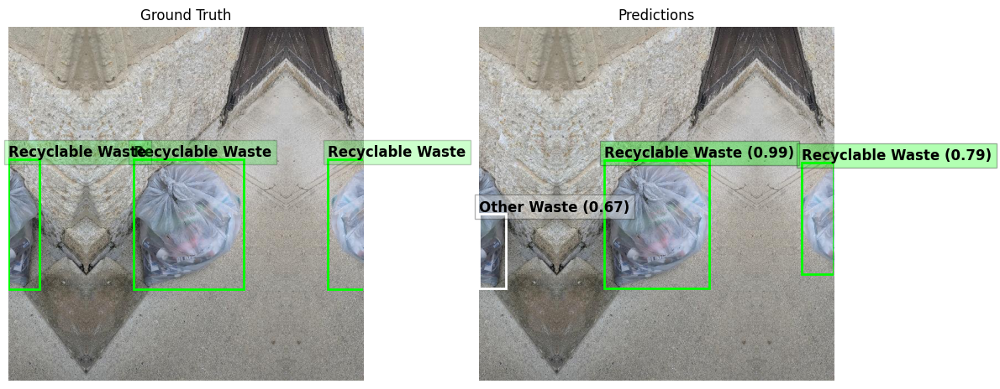











Ground Truth Labels

Other Waste: 1
Mixed Waste: 8
Predicted Labels

Mixed Waste: 9
Organic Waste: 1
Other Waste: 2
Recyclable Waste: 2


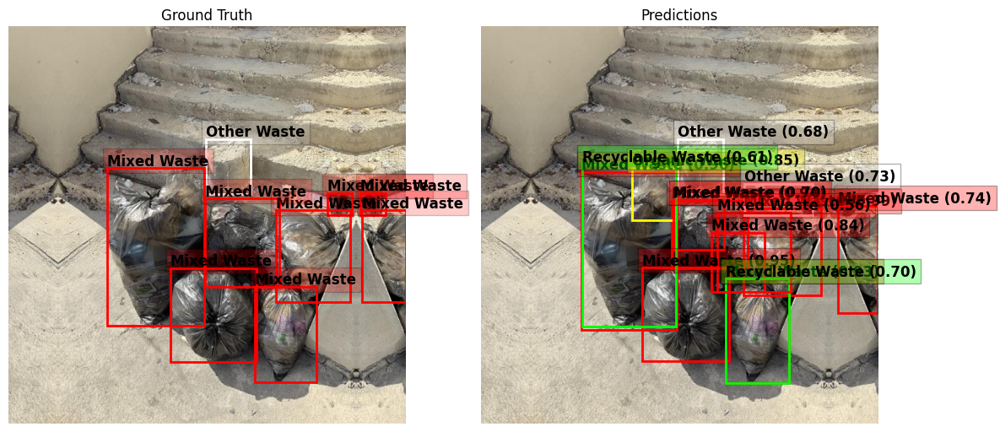











Ground Truth Labels

Organic Waste: 2
Predicted Labels

Organic Waste: 2


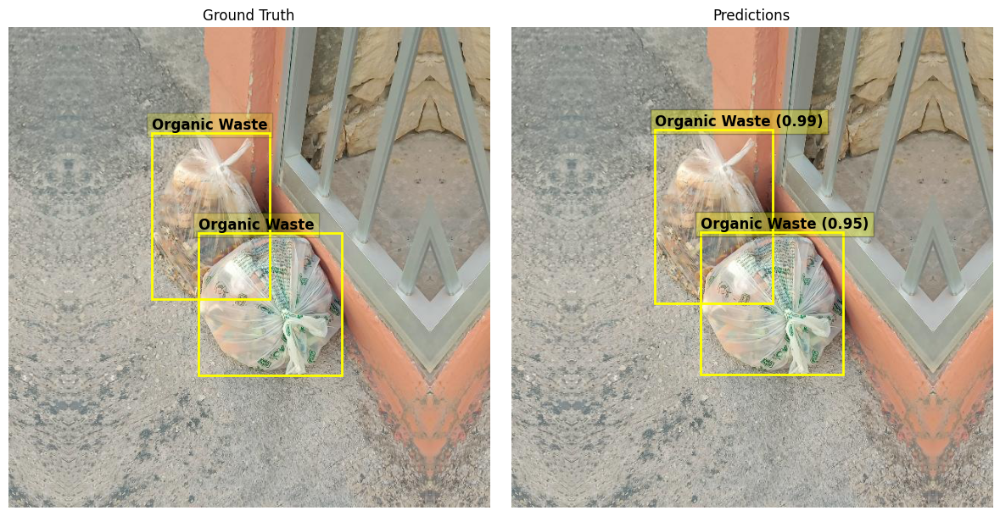











Ground Truth Labels

Mixed Waste: 3
Predicted Labels

Mixed Waste: 1


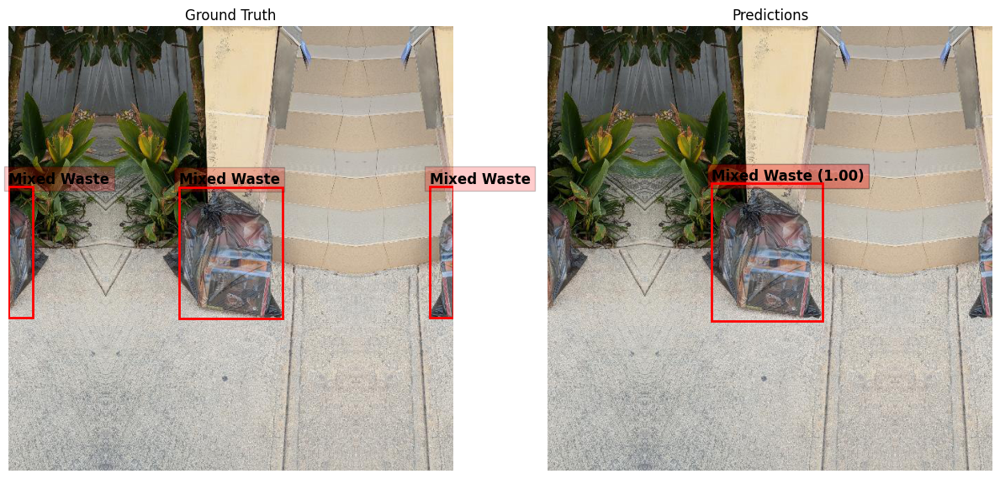











Ground Truth Labels

Recyclable Waste: 3
Other Waste: 1
Predicted Labels

Recyclable Waste: 4
Organic Waste: 1
Other Waste: 1


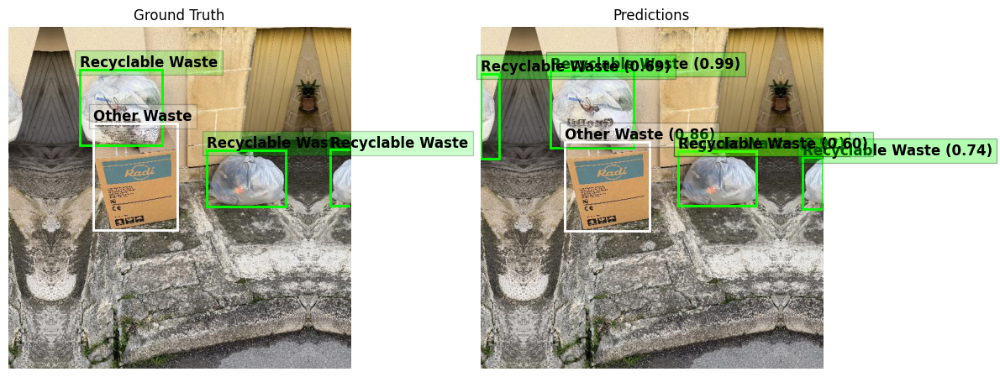











Ground Truth Labels

Mixed Waste: 3
Predicted Labels

Mixed Waste: 3


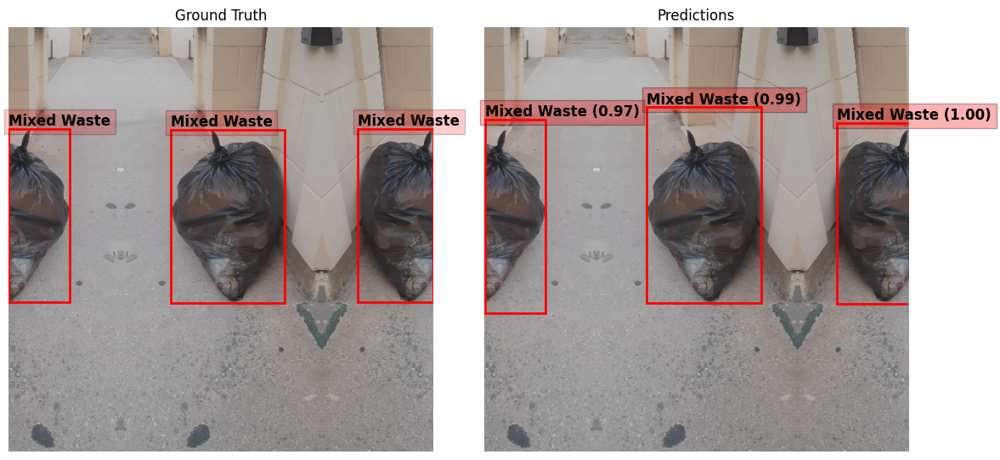











Ground Truth Labels

Organic Waste: 1
Predicted Labels

Organic Waste: 1


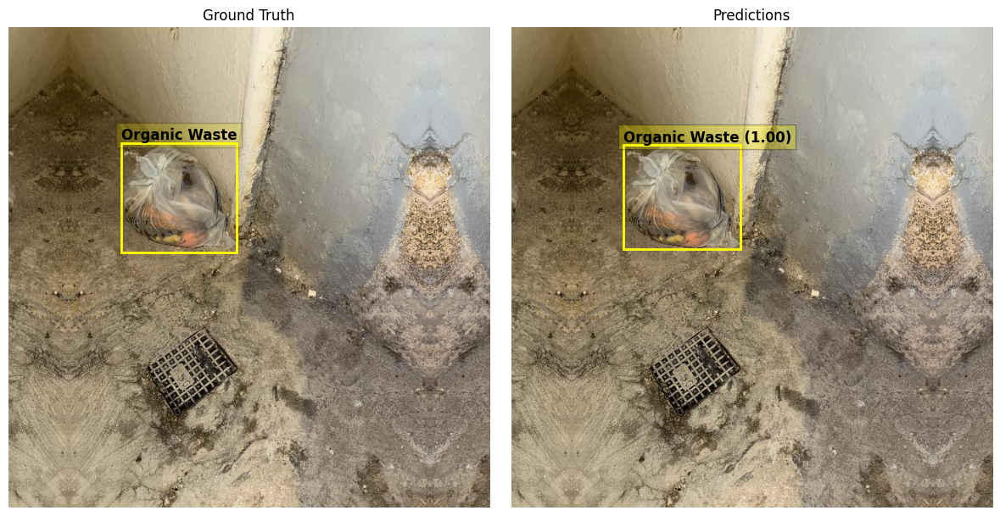











Ground Truth Labels

Mixed Waste: 2
Other Waste: 2
Predicted Labels

Mixed Waste: 2
Other Waste: 5


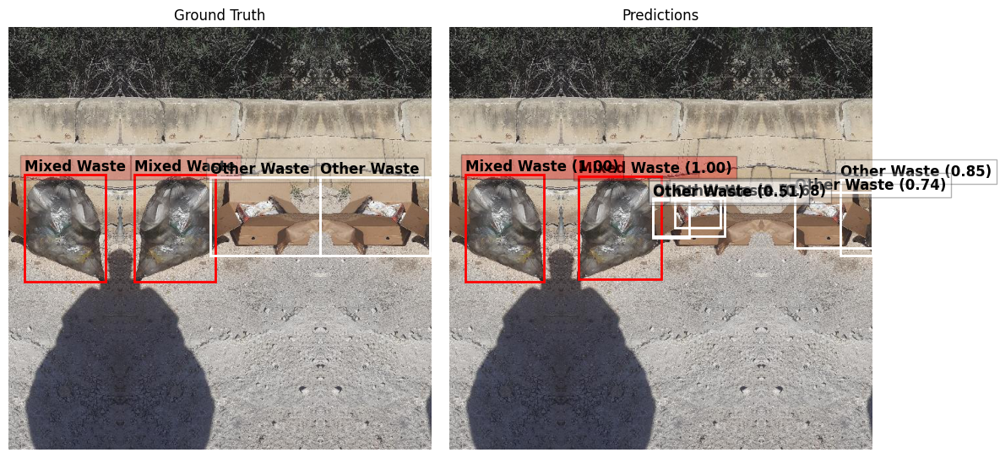











Ground Truth Labels

Organic Waste: 1
Predicted Labels

Organic Waste: 1


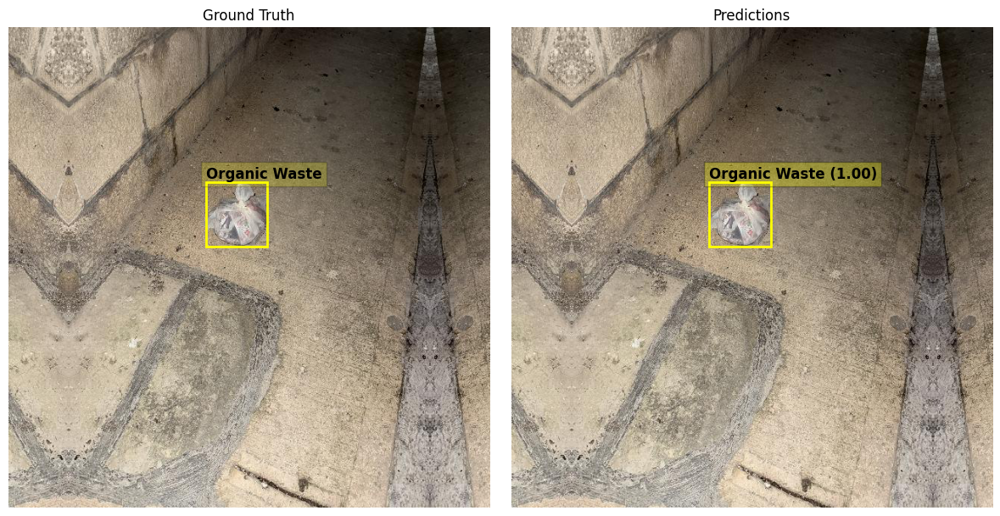











Ground Truth Labels

Recyclable Waste: 2
Predicted Labels

Recyclable Waste: 3


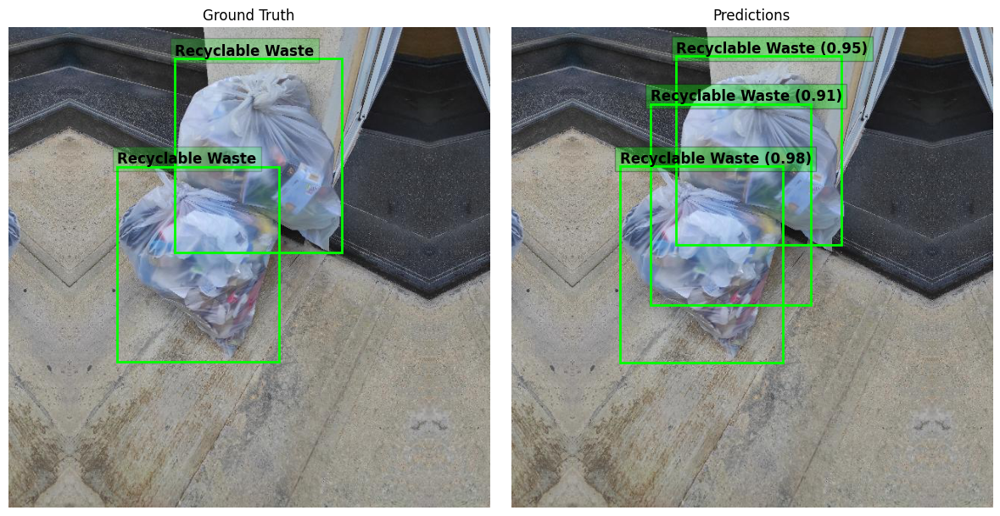











Ground Truth Labels

Mixed Waste: 6
Predicted Labels

Mixed Waste: 6


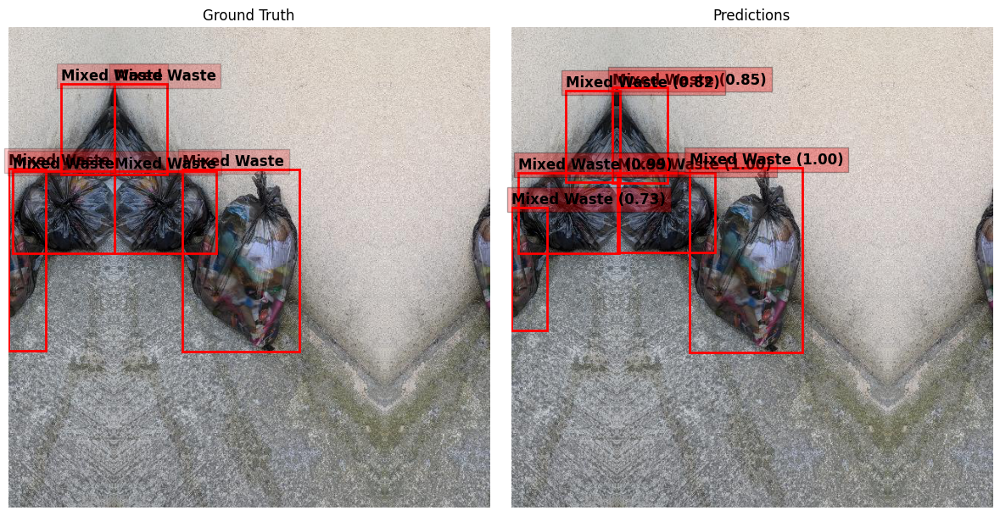











Ground Truth Labels

Organic Waste: 1
Predicted Labels

Organic Waste: 1


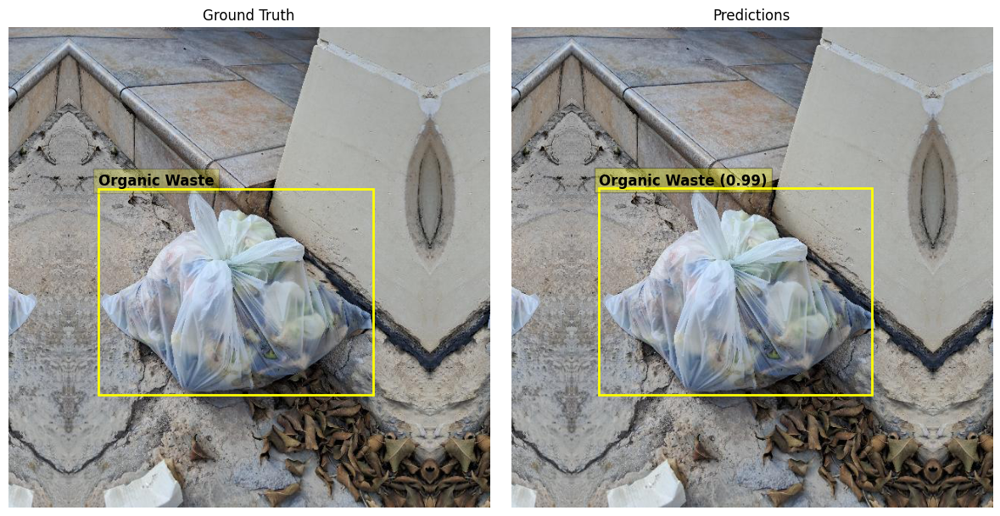











Ground Truth Labels

Organic Waste: 2
Mixed Waste: 3
Predicted Labels

Mixed Waste: 4
Organic Waste: 2


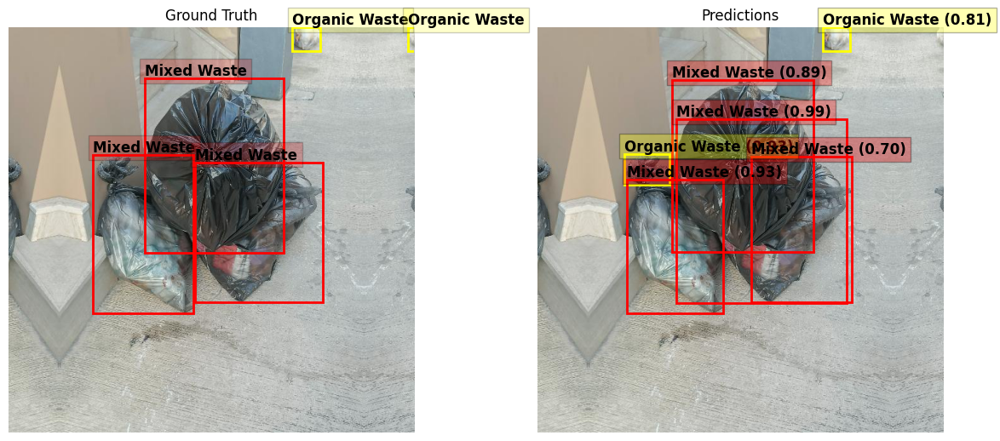











Ground Truth Labels

Mixed Waste: 5
Predicted Labels

Mixed Waste: 3
Recyclable Waste: 1


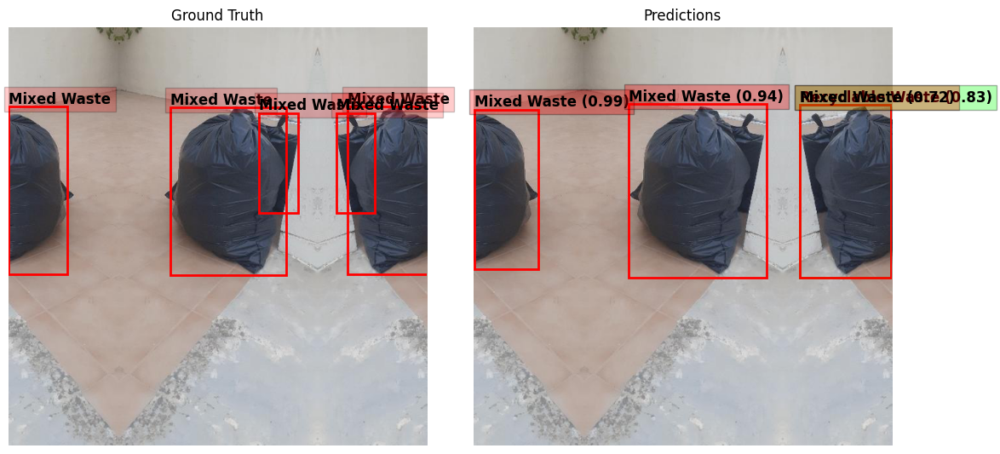











Ground Truth Labels

Recyclable Waste: 4
Predicted Labels

Recyclable Waste: 4
Organic Waste: 1


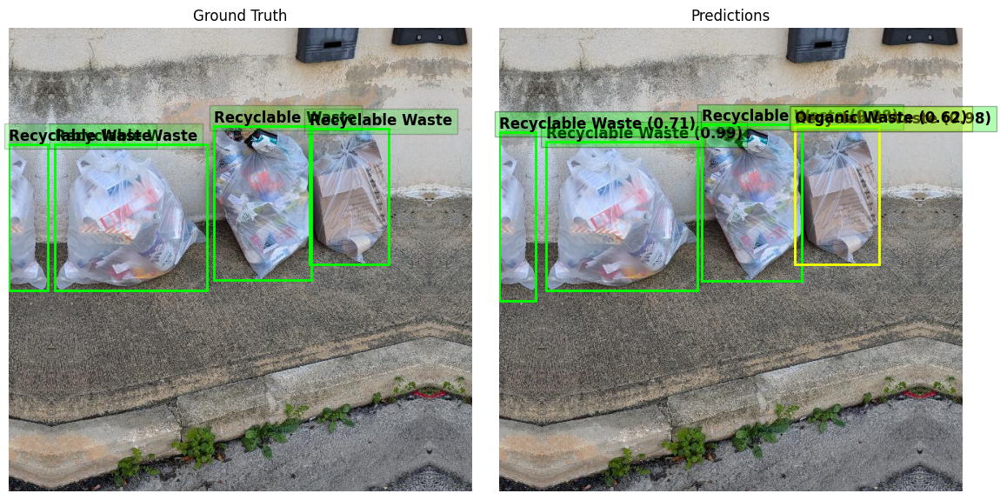











Ground Truth Labels

Organic Waste: 2
Predicted Labels

Organic Waste: 2


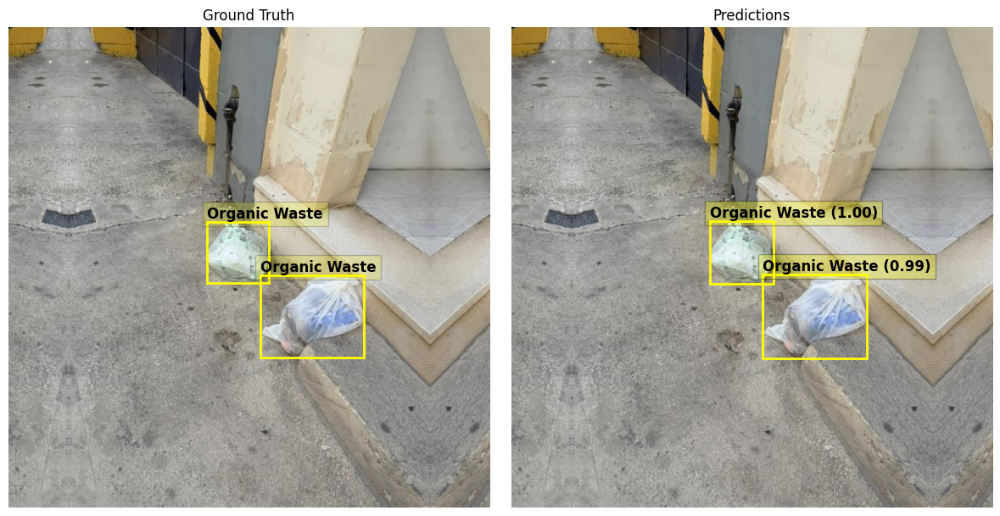











Ground Truth Labels

Mixed Waste: 1
Predicted Labels

Mixed Waste: 1
Recyclable Waste: 2


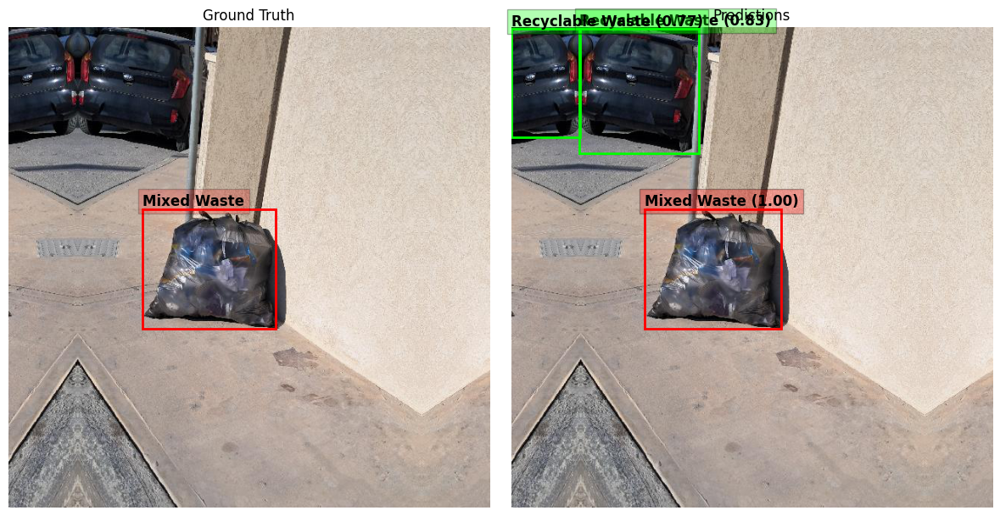











Ground Truth Labels

Recyclable Waste: 1
Predicted Labels

Recyclable Waste: 1


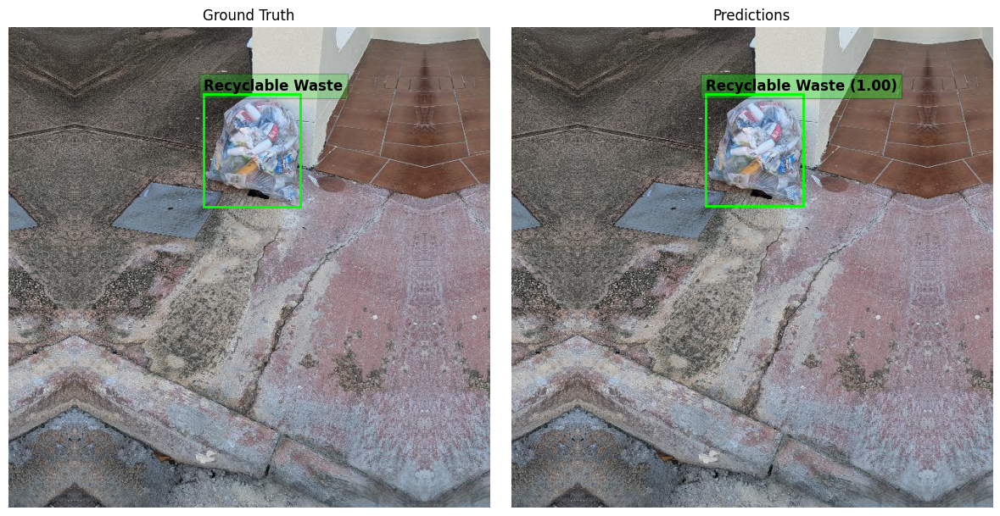











Ground Truth Labels

Organic Waste: 1
Predicted Labels

Organic Waste: 1
Mixed Waste: 1


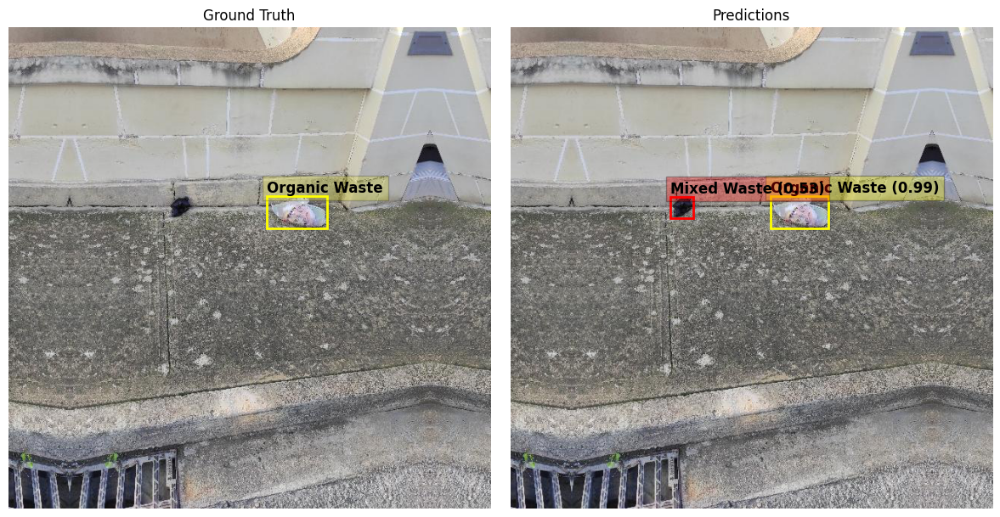











Ground Truth Labels

Mixed Waste: 6
Other Waste: 4
Predicted Labels

Mixed Waste: 8
Other Waste: 3


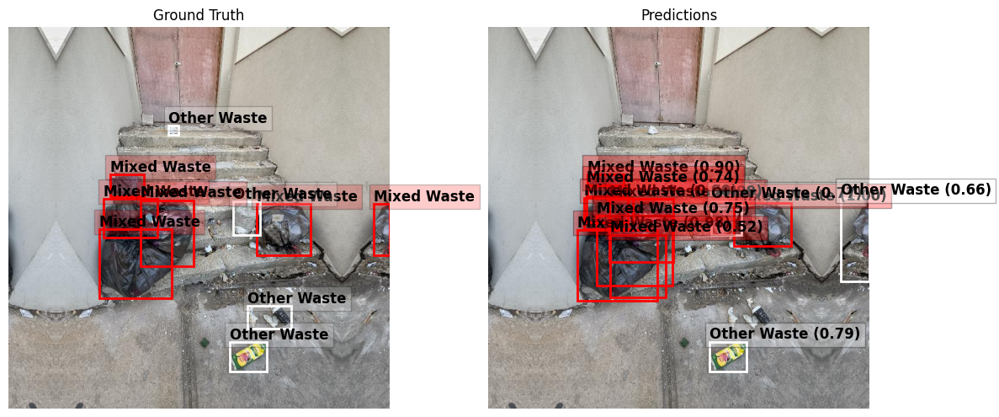











Ground Truth Labels

Recyclable Waste: 2
Predicted Labels

Recyclable Waste: 2
Organic Waste: 1


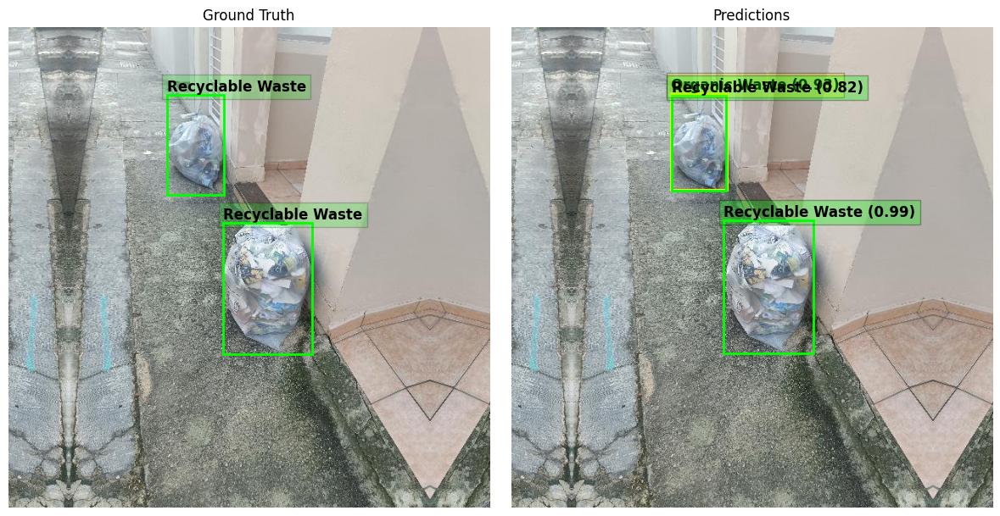











Ground Truth Labels

Mixed Waste: 2
Predicted Labels

Mixed Waste: 1


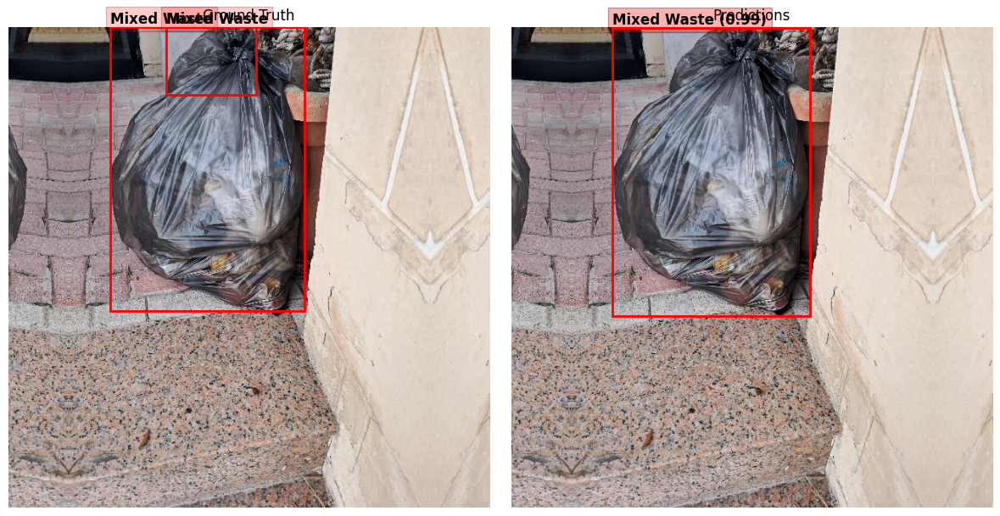











Ground Truth Labels

Recyclable Waste: 3
Predicted Labels

Recyclable Waste: 3


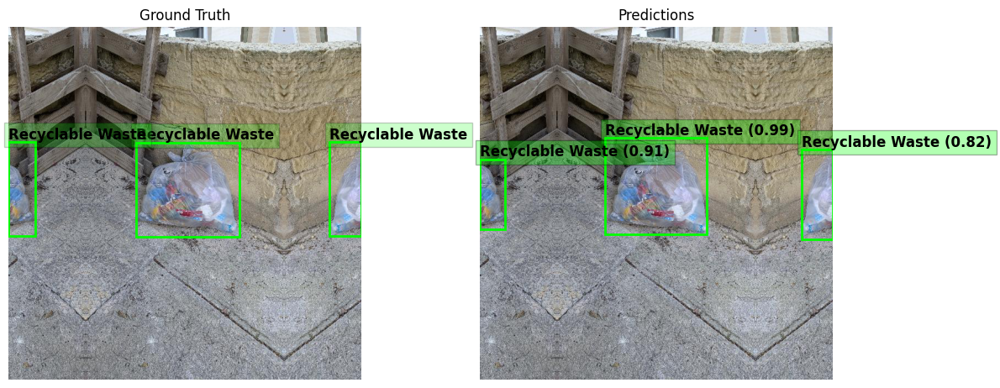











Ground Truth Labels

Recyclable Waste: 1
Predicted Labels

Recyclable Waste: 1
Organic Waste: 1


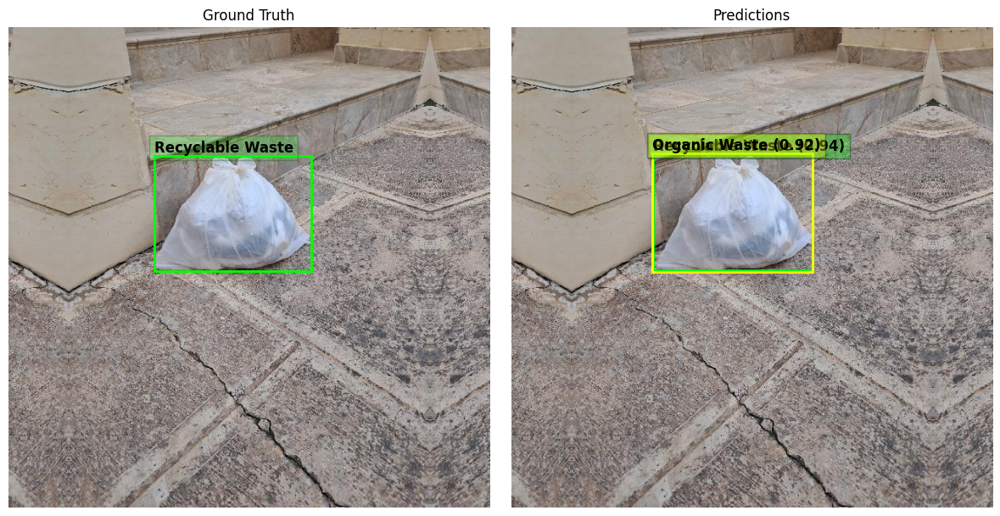











Ground Truth Labels

Organic Waste: 1
Predicted Labels

Organic Waste: 1


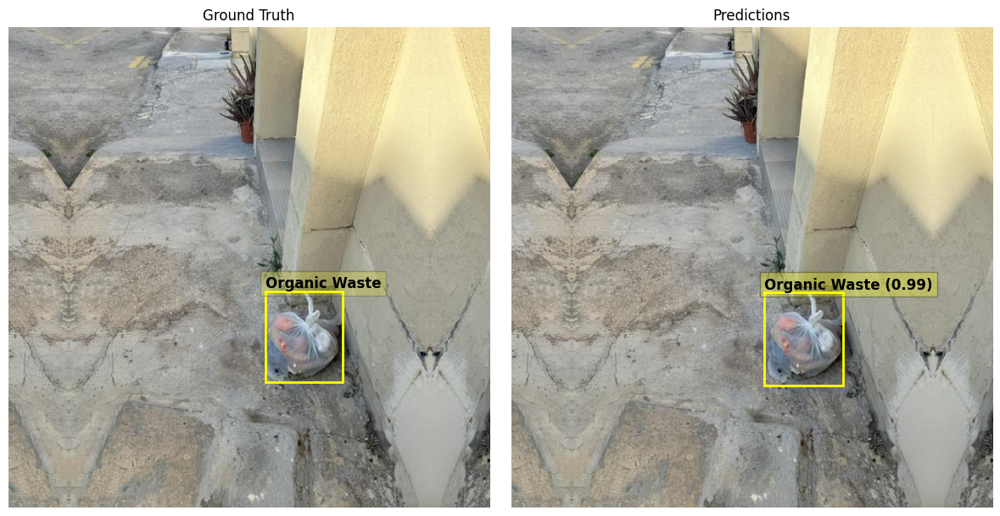











Ground Truth Labels

Mixed Waste: 10
Predicted Labels

Mixed Waste: 8
Recyclable Waste: 1


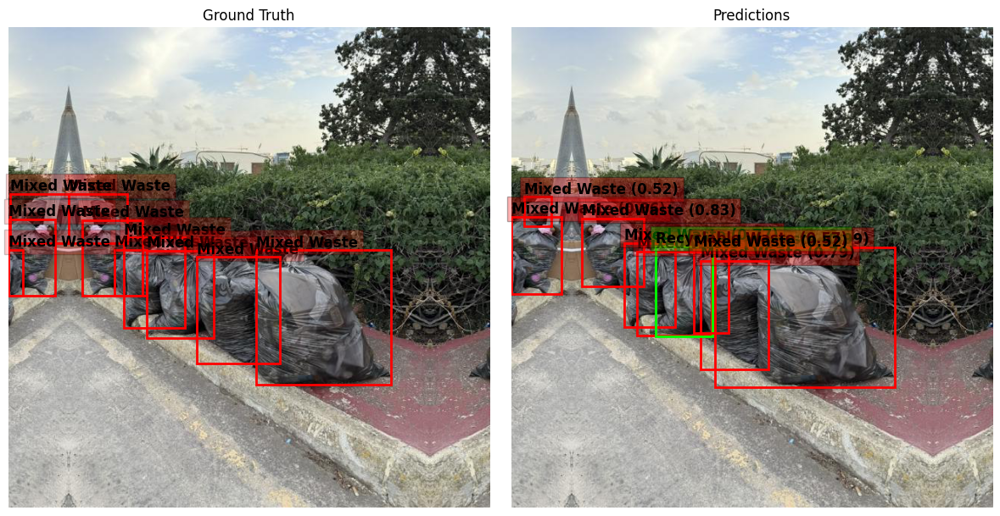











Ground Truth Labels

Mixed Waste: 1
Predicted Labels

Mixed Waste: 1


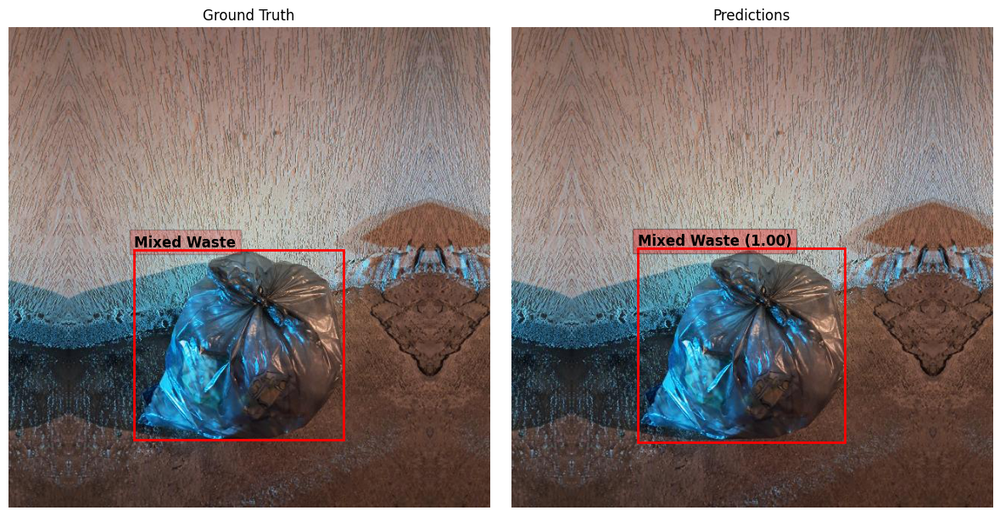











Ground Truth Labels

Recyclable Waste: 15
Other Waste: 2
Predicted Labels

Recyclable Waste: 6
Mixed Waste: 2
Organic Waste: 1


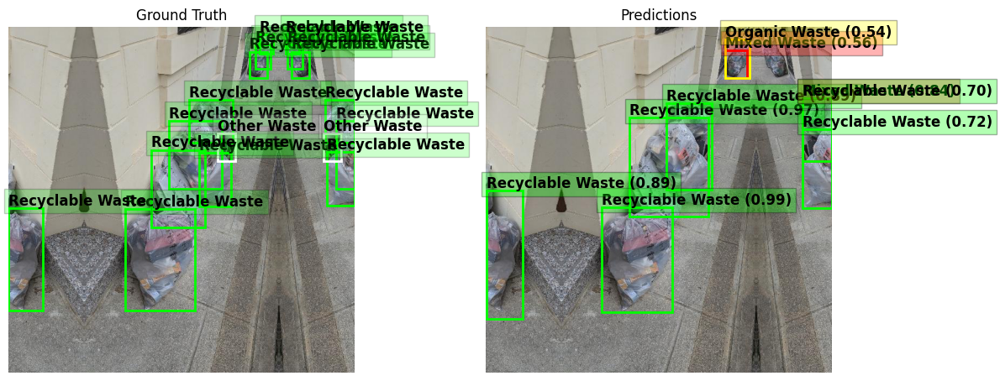











Ground Truth Labels

Organic Waste: 1
Predicted Labels

Organic Waste: 1


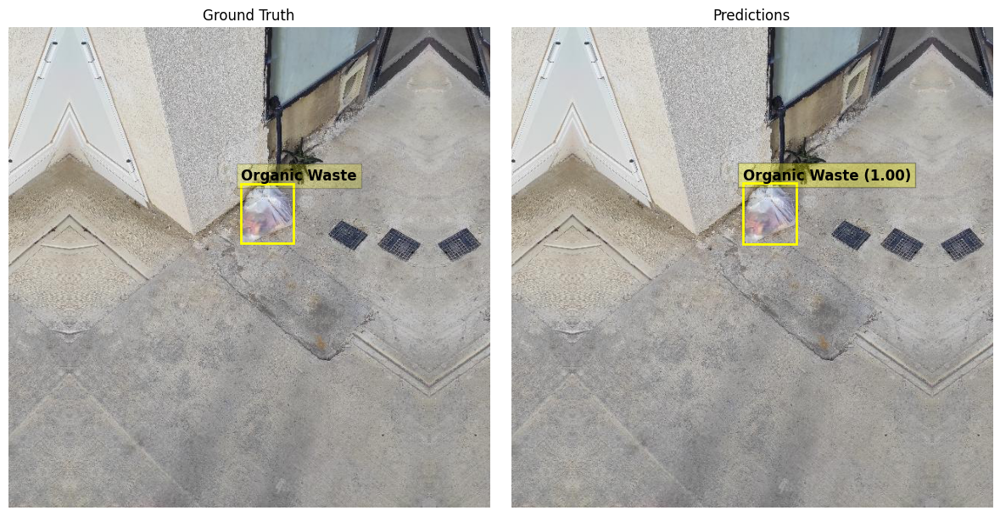











Ground Truth Labels

Recyclable Waste: 10
Other Waste: 3
Predicted Labels

Recyclable Waste: 6
Other Waste: 4
Organic Waste: 3


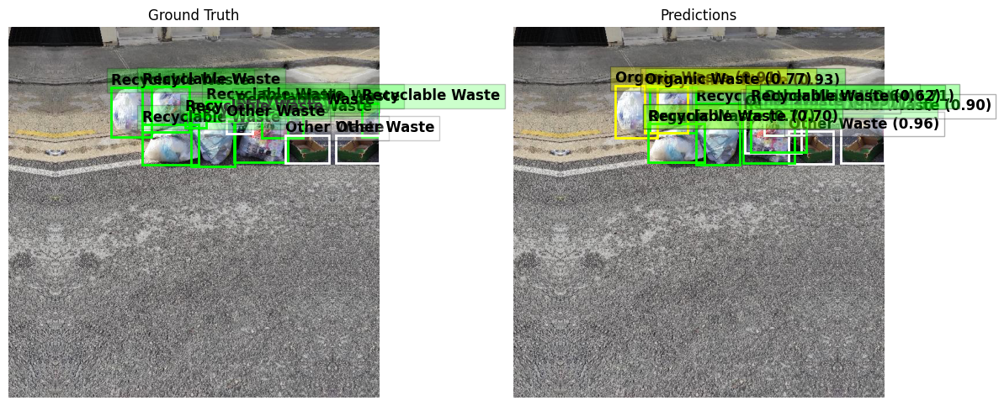

In [13]:
from collections import Counter

category_names = {1: "Mixed Waste", 4: "Recyclable Waste", 2: "Organic Waste", 3: "Other Waste"}
category_colors = {1: "red", 4: "lime", 2: "yellow", 3: "white"}

def visualize_predictions(image, target, prediction, confidence_threshold=0.5):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))  # Create two subplots: one for GT, one for prediction
    
    for _ in range(10):
        print()
    # Plot ground truth on the left
    ax1.imshow(image.permute(1, 2, 0).cpu().numpy())  # Convert from tensor to numpy for display
    ax1.set_title("Ground Truth")
    
    # Plot bounding boxes for ground truth
    for box, label in zip(target["boxes"], target["labels"]):
        color = category_colors.get(label.item(), "white")
        box = box.cpu().numpy()
        rect = patches.Rectangle(
            (box[0], box[1]), box[2] - box[0], box[3] - box[1],
            linewidth=2, edgecolor=color, facecolor="none"
        )
        ax1.add_patch(rect)
        ax1.text(
            box[0], box[1] - 5, f"{category_names[label.item()]}",
            color="black", fontsize=12, weight="bold", bbox=dict(facecolor=color, alpha=0.2)
        )

    # Showing the number of instances of each category in the image
    label_counts = Counter(target["labels"].cpu().numpy())
    print("Ground Truth Labels")
    print()
    for label, count in label_counts.items():
        print(f"{category_names[label]}: {count}")
    
    ax1.axis("off")

    ax2.imshow(image.permute(1, 2, 0).cpu().numpy())
    ax2.set_title("Predictions")

    # NMS
    keep = prediction["scores"] > confidence_threshold
    boxes = prediction["boxes"][keep]
    labels = prediction["labels"][keep]
    scores = prediction["scores"][keep]

    for box, label, score in zip(boxes, labels, scores):
        color = category_colors[max(1, int(label.cpu()))]
        box = box.cpu().numpy()
        rect = patches.Rectangle(
            (box[0], box[1]), box[2] - box[0], box[3] - box[1],
            linewidth=2, edgecolor=color, facecolor="none"
        )
        ax2.add_patch(rect)
        ax2.text(
            box[0], box[1] - 5, f"{category_names[max(1, int(label.cpu()))]} ({score:.2f})",
            color="black", fontsize=12, weight="bold", bbox=dict(facecolor=color, alpha=0.3)
        )

    # Showing the number of predictions for each category in the image
    print("=============")
    label_counts = Counter(labels.cpu().numpy())
    print("Predicted Labels")
    print()
    for label, count in label_counts.items():
        print(f"{category_names[label]}: {count}")

    ax2.axis("off")

    plt.tight_layout()
    plt.show()


for images, targets in test_dataloader:
    images = [image.to(device) for image in images]
    targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

    with torch.no_grad():
        predictions = model(images)

    # Visualize the predictions for each image in the batch
    for i in range(len(images)):
        visualize_predictions(images[i], targets[i], predictions[i])